In [2]:
import os
import json
from PIL import Image
import torch
from torch.utils.data import Dataset
import xml.etree.ElementTree as ET
import torchvision
from torchvision.models.detection import MaskRCNN
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor
from torchvision.datasets import CocoDetection
from torch.utils.data import DataLoader
from torchvision import transforms
import glob
from typing import Dict
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from torch.cuda.amp import GradScaler


def get_MRCNN_model():
    num_classes = 2  # Roof & background
    # Load a pre-trained Mask R-CNN model
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)
    # Modify the classification head
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    # Modify the mask head
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 128
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask, hidden_layer, num_classes)
    # Add dropout to the mask head
    dropout_prob = 0.5
    model.roi_heads.mask_predictor.dropout = torch.nn.Dropout(p=dropout_prob)
    return model

def collate_fn(batch):
    inputs = [sample.pop("image") for sample in batch]
    targets = batch
    for target in targets:
        target["labels"] = torch.from_numpy(target["labels"]).long()
    return inputs, targets

def img_transform(sample):
    image = sample['image']
    boxes = sample['boxes']
    labels = sample['labels']
    masks = sample['masks']
    boxes = torch.from_numpy(boxes).float()
    channels, height, width = image.shape

    # Convert the NumPy array to a PIL Image
    image = Image.fromarray(np.uint8(image.transpose(1, 2, 0)))

    img_type = type(image)

    # Define your custom transformations here
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Resize((800, 800), antialias=True),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        transforms.RandomApply([transforms.ColorJitter(brightness=0.01, contrast=0.01, saturation=0.01, hue=0.01)], p=0.2),
        transforms.RandomApply([transforms.GaussianBlur(kernel_size=3, sigma=(0.1, 1.0))], p=0.1),
        transforms.RandomGrayscale(p=0.1),
    ])


    target_size = (800, 800)
    scale = torch.tensor([target_size[0] / height, target_size[1] / width])
    masks = torch.from_numpy(masks).float()
    masks = torch.nn.functional.interpolate(masks[:, None], size=target_size, mode='bilinear', align_corners=False)
    masks = (masks[:, 0] > 0.5).float()
    boxes *= torch.cat([scale, scale])

    # Apply the transformations to the image
    image = transform(image)

    # Return the updated sample
    sample['image'] = image
    sample['boxes'] = boxes
    sample['labels'] = labels
    sample['masks'] = masks

    return sample

class CustomDataset(Dataset):
    def __init__(self, train_dir, label_dir, transform) -> None:
        super().__init__()
        self.train_dir = train_dir
        self.transform = transform
        self.files = sorted(glob.glob(os.path.join(self.train_dir, "*.npz")))

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx: int) -> Dict[str, torch.Tensor]:
        path = self.files[idx]

        x = np.load(path)
        if 'image' not in x or 'masks' not in x or 'boxes' not in x or 'labels' not in x:
            raise KeyError("Required keys are missing in the NPZ file")

        image = x['image']
        masks = x['masks']
        boxes = x['boxes']
        labels = x['labels']

        sample = {'image': image, 'masks': masks, 'boxes': boxes, 'labels': labels}
        image_to_show = sample["image"].transpose(1, 2, 0)

        if self.transform:
            sample = self.transform(sample)

        image_to_show = sample["image"].permute(1, 2, 0)

        return sample

def calculate_iou(predicted_mask, ground_truth_mask):
    predicted_mask = predicted_mask.astype(bool)
    ground_truth_mask = ground_truth_mask.astype(bool)

    intersection = (predicted_mask & ground_truth_mask).sum()
    union = (predicted_mask | ground_truth_mask).sum()
    iou = intersection / (union + 1e-5)  # Add a small epsilon to avoid division by zero
    return iou.item()

def validate_model(model, data_loader, device):
    model.eval()
    all_predicted_masks = []
    all_ground_truth_masks = []
    all_losses = []
    count = 0
    with torch.no_grad():
        for batch in data_loader:
            images, batch_targets = batch
            image_tensor = [image.to(device) for image in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in batch_targets]

            for i in range(len(images)):
                nodata = batch_targets[i]["masks"].sum(dim=0).to(torch.bool).detach()
                images[i] = images[i] * nodata[None, ...]

            prediction = model(image_tensor)

            for pred in prediction:
                pred["masks"] = pred["masks"].squeeze(dim=1).round().to(torch.uint8)

            for pred in prediction:
                indices = torchvision.ops.nms(
                    boxes=pred["boxes"],
                    scores=pred["scores"],
                    iou_threshold=0.5,
                )
                indices = reversed(indices)
                pred["masks"] = pred["masks"][indices, ...]
                pred["boxes"] = pred["boxes"][indices, ...]
                pred["labels"] = pred["labels"][indices]
                pred["scores"] = pred["scores"][indices]

            # Calculate losses
            for i in range(len(images)):
                pred_combined_mask = torch.sum(prediction[i]["masks"], dim=0)
                target_combined_mask = torch.sum(targets[i]["masks"], dim=0)
                loss = criterion(pred_combined_mask.float(), target_combined_mask.float())
                all_losses.append(loss.item())


                gt_mask_np = target_combined_mask.cpu().numpy()
                predicted_mask_np = pred_combined_mask.cpu().numpy()

                all_ground_truth_masks.append(gt_mask_np)
                all_predicted_masks.append(predicted_mask_np)
                count = count+1
        print(f"Val Loss Len: {len(all_losses)}")
        print(f"Pred mask Len: {len(all_predicted_masks)}")
        # Calculate average loss and IOU
        average_loss = sum(all_losses) / len(all_losses)
        average_iou = sum([calculate_iou(pred, gt) for pred, gt in zip(all_predicted_masks, all_ground_truth_masks)]) / len(all_predicted_masks)

    return average_loss, average_iou

def plot_losses(train_losses, val_losses, epoch):
    plt.figure(figsize=(10, 5))
    plt.plot(range(1, epoch + 1), train_losses, label='Train Loss')
    plt.plot(range(1, epoch + 1), val_losses, label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

def plot_iou(val_iou, epoch):
    plt.figure(figsize=(10, 5))
    plt.plot(range(1, epoch + 1), val_iou, label='Validation IOU')
    plt.title('Validation IOU')
    plt.xlabel('Epoch')
    plt.ylabel('IOU')
    plt.legend()
    plt.show()

def dice_loss(predicted, target, smooth=1e-5):
    intersection = (predicted * target).sum()
    union = predicted.sum() + target.sum()
    dice = (2.0 * intersection + smooth) / (union + smooth)
    return 1 - dice

train_path = "/content/drive/MyDrive/Colab Notebooks/zrg/zrg1k"
val_path = "/content/drive/MyDrive/Colab Notebooks/zrg/zrg100"
test_path = "/content/drive/MyDrive/Colab Notebooks/zrg/zrg-test"

# Number of epochs
num_epochs = 10
train_dataset = CustomDataset(train_path, train_path, transform=img_transform)
train_loader = DataLoader(train_dataset, batch_size=5, shuffle=True, num_workers=0, collate_fn=collate_fn)
print(f"Train Data No: {len(train_dataset)}")

val_dataset = CustomDataset(val_path, val_path, transform=img_transform)
val_loader = DataLoader(val_dataset, batch_size=5, shuffle=True, num_workers=0, collate_fn=collate_fn)
print(f"Validation Data No: {len(val_dataset)}")

test_dataset = CustomDataset(test_path, test_path, transform=img_transform)
test_loader = DataLoader(test_dataset, batch_size=5, shuffle=True, num_workers=0, collate_fn=collate_fn)
print(f"Test Data No: {len(test_dataset)}")

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = get_MRCNN_model().to(device)

# Construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=1e-3, momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)

# Lists to store metrics
train_losses = []
val_losses = []
train_ious = []
val_ious = []


# criterion
criterion = dice_loss

Train Data No: 155
Validation Data No: 100
Test Data No: 222


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=MaskRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth" to /root/.cache/torch/hub/checkpoints/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth
100%|██████████| 170M/170M [00:01<00:00, 116MB/s]


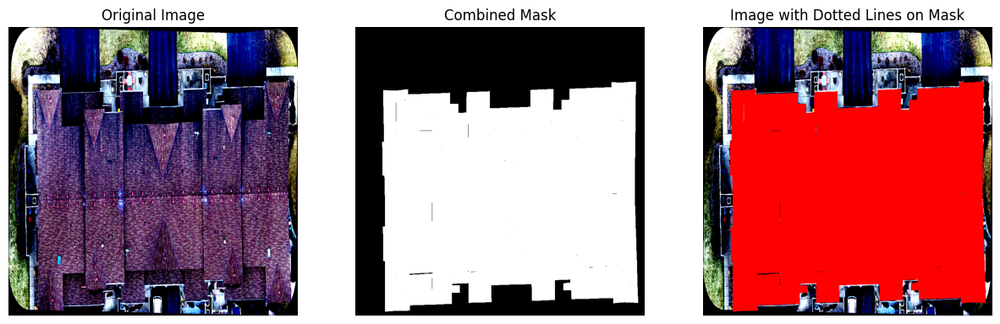

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_first_batch(train_loader):
    # Get the first batch from the loader
    for batch in train_loader:
        images, targets = batch
        sample = {'image': images[0], 'masks': targets[0]['masks']}

        # Plot the original image
        plt.figure(figsize=(15, 5))
        plt.subplot(131)
        plt.imshow(sample['image'].permute(1, 2, 0))
        plt.title("Original Image")
        plt.axis("off")


        combined_masks = sample['masks'].permute(1, 2, 0).sum(axis=2).squeeze()
        plt.subplot(132)
        plt.imshow(combined_masks, cmap='gray')
        plt.title("Mask")
        plt.axis("off")


        plt.subplot(133)
        mask_coords = combined_masks > 0
        image_with_lines = sample['image'].squeeze(0).clone().permute(1, 2, 0).cpu().numpy()
        image_with_lines[mask_coords] = [1, 0, 0]  # Highlight in red
        plt.imshow(image_with_lines)
        plt.title("Superimposed Mask Train Image for  Visualization")
        plt.axis("off")

        plt.show()
        break


plot_first_batch(train_loader)


## Train

Val Loss Len: 100
Pred mask Len: 100
Epoch 1, Train Loss: 3.788356873296922, Val Loss: 0.47685045063495635, Val IOU: 0.27559816655466013
Val Loss Len: 100
Pred mask Len: 100
Epoch 2, Train Loss: 2.3576497339433238, Val Loss: 0.14895072519779207, Val IOU: 0.4139171844318985
Val Loss Len: 100
Pred mask Len: 100
Epoch 3, Train Loss: 2.1649739088550692, Val Loss: 0.09408704161643983, Val IOU: 0.4110179196533189
NaN loss at epoch 4, batch 15
Intermediate results and parameters for debugging.
Val Loss Len: 100
Pred mask Len: 100
Epoch 4, Train Loss: 2.1078800757726035, Val Loss: 0.17356959879398345, Val IOU: 0.37910856053532366
Val Loss Len: 100
Pred mask Len: 100
Epoch 5, Train Loss: 2.0349373125260874, Val Loss: 0.25577822685241697, Val IOU: 0.36437822840443235
Val Loss Len: 100
Pred mask Len: 100
Epoch 6, Train Loss: 1.9715072224217076, Val Loss: 0.24667317926883697, Val IOU: 0.37163250843997986
Val Loss Len: 100
Pred mask Len: 100
Epoch 7, Train Loss: 1.9135552644729614, Val Loss: 0.2697

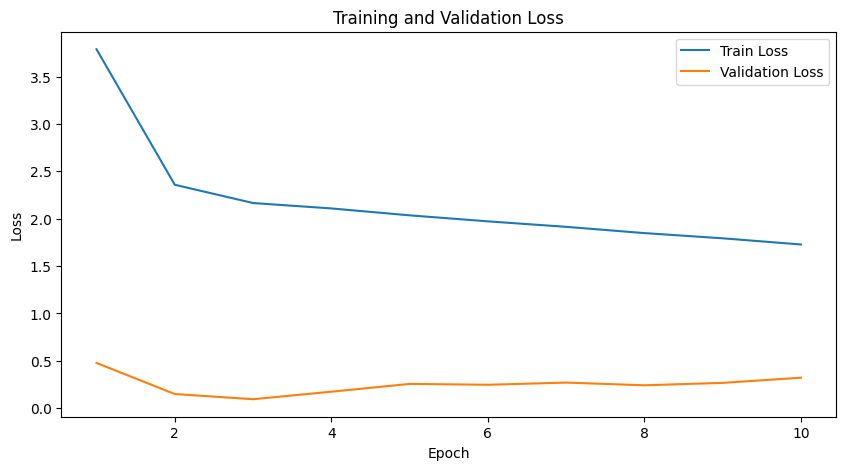

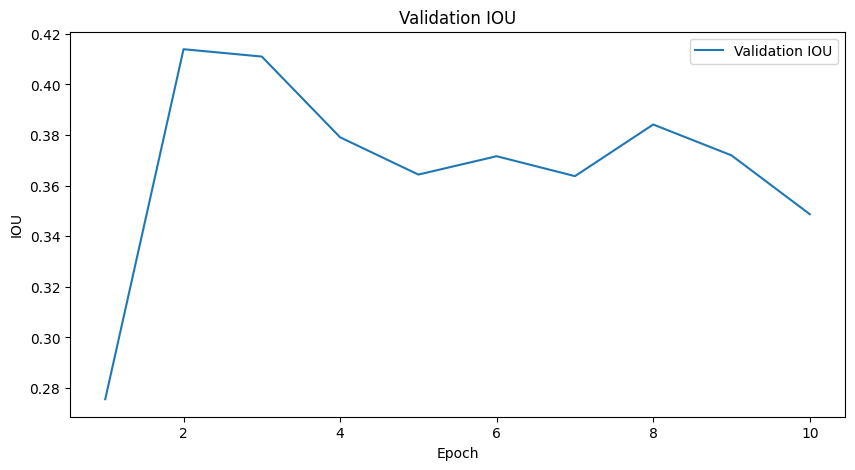

In [2]:
# Training loop
for epoch in range(num_epochs):
    model.train()
    losses = []
    ious = []
    for batch_idx, batch in enumerate(train_loader):
        images, targets = batch
        images = [image.to(device) for image in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        for i in range(len(images)):
            nodata = targets[i]["masks"].sum(dim=0).to(torch.bool).detach()
            images[i] = images[i] * nodata[None, ...]

        loss_dict = model(images, targets)
        loss = sum(loss for loss in loss_dict.values())

        if torch.isnan(loss):
            print(f"NaN loss at epoch {epoch + 1}, batch {batch_idx}")
            print("Intermediate results and parameters for debugging.")
            for name, param in model.named_parameters():
                if torch.isnan(param).any():
                    print(f"NaN parameter: {name}")
            break
        else:
            optimizer.zero_grad()
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()
            losses.append(loss.item())


    train_loss = sum(losses) / len(losses)
    train_losses.append(train_loss)


    # Validation loop
    val_loss, val_iou = validate_model(model, val_loader, device)
    val_losses.append(val_loss)
    val_ious.append(val_iou)

    print(f"Epoch {epoch + 1}, Train Loss: {train_loss}, Val Loss: {val_loss}, Val IOU: {val_iou}")

    # Save the model
    model_state_file = f"/content/drive/MyDrive/Colab Notebooks/zrg/model_epoch_{epoch + 1}.pth"
    torch.save(model.state_dict(), model_state_file)


print(f"Length of train_losses: {len(train_losses)}")

print(f"Length of val_losses: {len(val_losses)}")
print(f"Length of val_ious: {len(val_ious)}")
# Write the loss and IOU values to Excel files
train_df = pd.DataFrame({
    "Epoch": list(range(1, epoch + 2)),
    "Train Loss": train_losses,
})

val_df = pd.DataFrame({
    "Epoch": list(range(1, epoch + 2)),
    "Val Loss": val_losses,
    "Val IOU": val_ious,
})

# Save to separate Excel files
train_df.to_excel("/content/drive/MyDrive/Colab Notebooks/zrg/train_loss.xlsx", index=False)
val_df.to_excel("/content/drive/MyDrive/Colab Notebooks/zrg/val_loss_iou.xlsx", index=False)

# Plot loss and IOU graphs
plot_losses(train_losses, val_losses, epoch + 1)
plot_iou(val_ious, epoch + 1)


# Test Loop

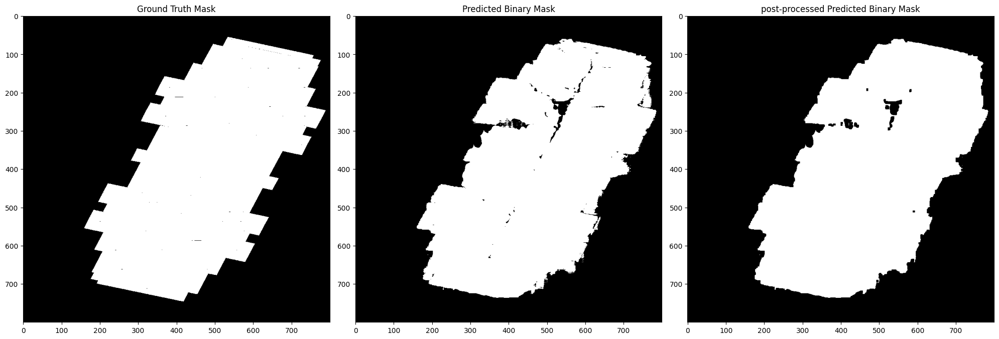

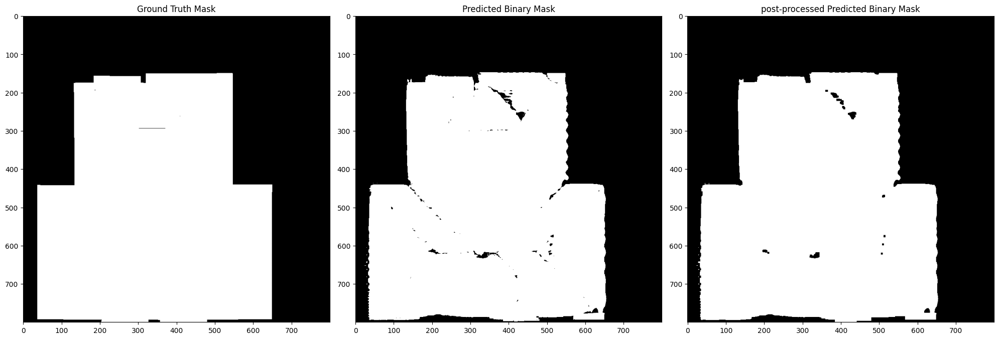

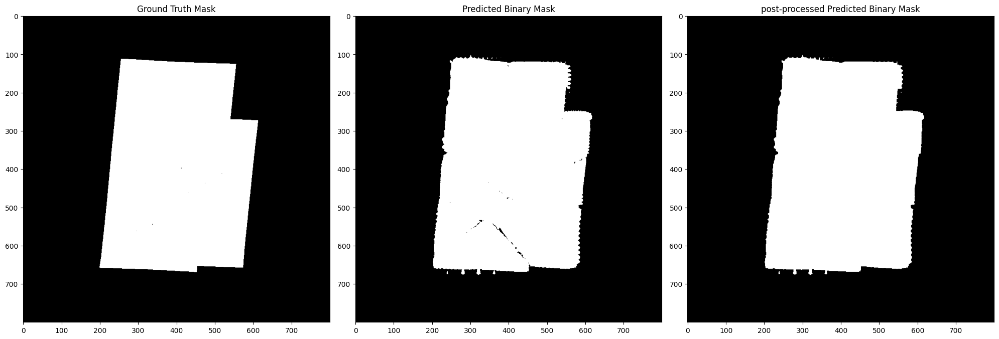

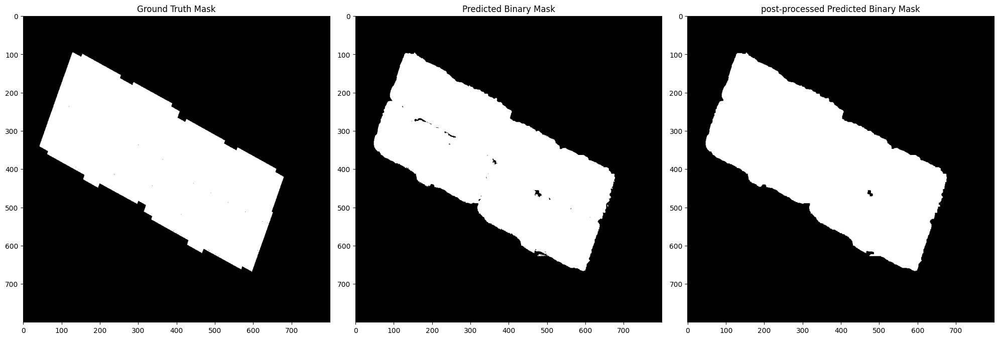

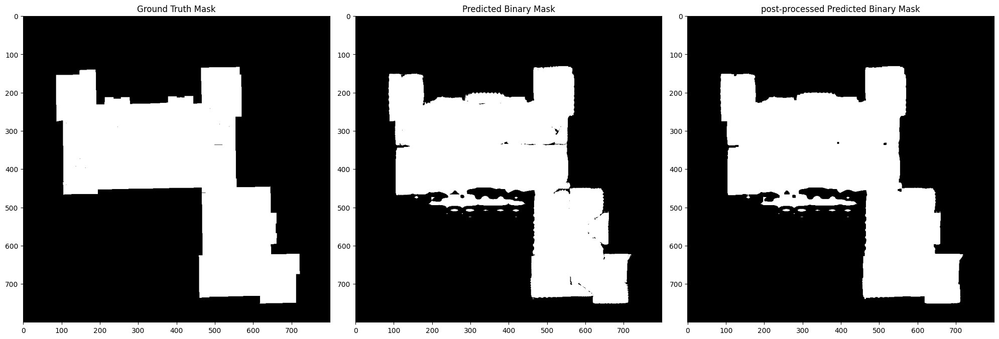

...

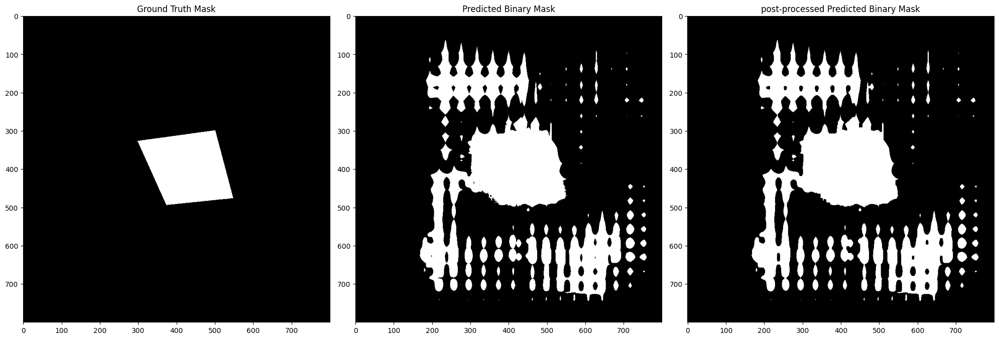

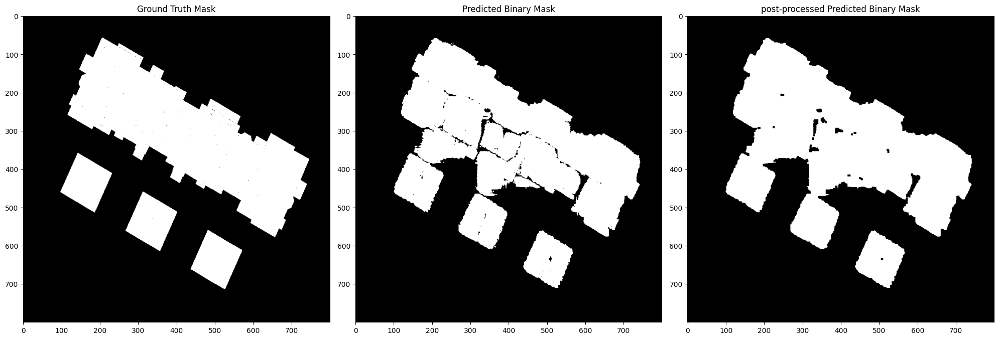

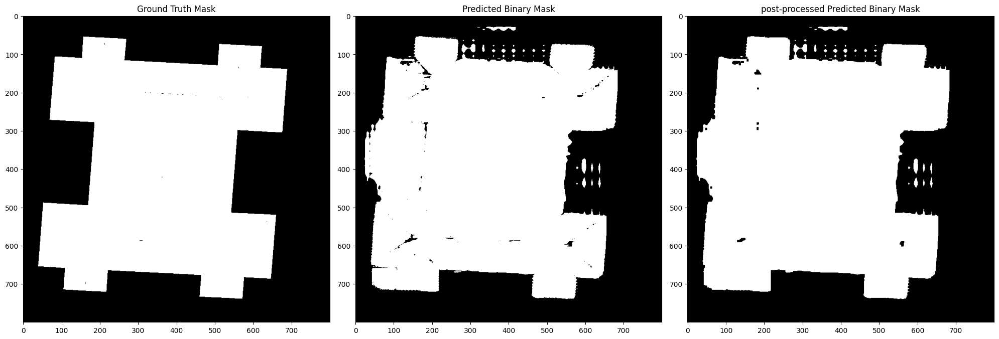

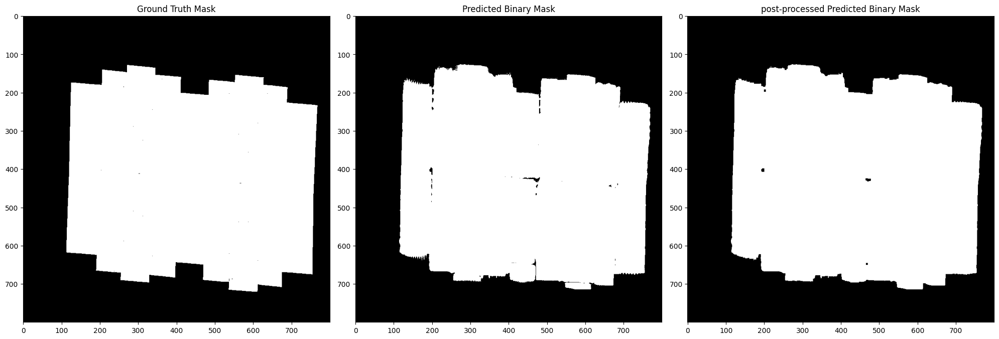

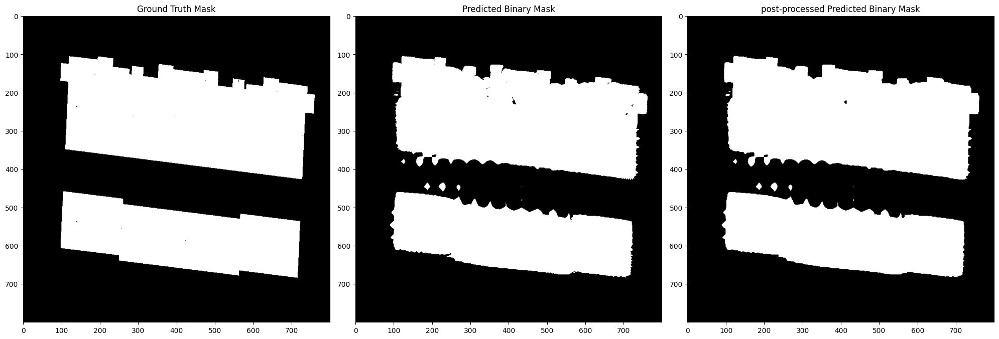

Average Test Loss: -0.5107393503726065
Average IOU: 0.867620453588998


In [6]:
import os
import matplotlib.pyplot as plt
import pandas as pd
from torchvision import transforms
from sklearn.metrics import precision_score, recall_score, accuracy_score
from sklearn.metrics import average_precision_score
from sklearn.metrics import jaccard_score
import torch
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torchvision
import numpy as np
import glob
import torch.nn.functional as F
import cv2



def generate_binary_mask(predicted_mask_np):
    return (predicted_mask_np > 0.5).astype(np.uint8)

def generate_color_mask(predicted_mask_np):
    colored_mask = np.zeros_like(predicted_mask_np)
    unique_labels = np.unique(predicted_mask_np)
    for idx, label in enumerate(unique_labels):
        if label == 0:
            continue
        mask = (predicted_mask_np == label).astype(np.uint8)
        colored_mask += mask * (idx + 1)  # Assign a unique color to each face
    return colored_mask

# Initialize an empty list to store predicted masks for all images
all_predicted_masks = []

# Initialize an empty list to store test losses
test_losses = []

# Initialize lists to store images, ground truth masks, and predicted masks for visualization
all_images = []
all_ground_truth_masks = []
all_predicted_mask_images = []
all_predicted_binary_masks = []
all_colormasks = []
# Initialize an empty list to store test losses per epoch
epoch_losses = []
epoch_ious = []
# Lists to store metrics
precision_scores = []
recall_scores = []
average_losses = []
iou_scores = []

criterion = dice_loss

roi_dir = "/content/drive/MyDrive/Colab Notebooks/zrg/roi"
contour_dir = "/content/drive/MyDrive/Colab Notebooks/zrg/contours"
colormask_dir = "/content/drive/MyDrive/Colab Notebooks/zrg/colormask"
binary_mask_dir = "/content/drive/MyDrive/Colab Notebooks/zrg/binarymask"
os.makedirs(binary_mask_dir, exist_ok=True)
os.makedirs(colormask_dir, exist_ok=True)
os.makedirs(roi_dir, exist_ok=True)
os.makedirs(contour_dir, exist_ok=True)
model.load_state_dict(torch.load("/content/drive/MyDrive/Colab Notebooks/zrg/model_epoch_10.pth", map_location=torch.device('cpu')))
# Loop through the test set and collect predicted masks
for idx, batch in enumerate(test_loader):
    current_epoch_losses = []
    current_epoch_ious = []
    torch.cuda.empty_cache()
    images, batch_targets = batch

    # Mask out the original image
    for i in range(len(images)):
        nodata = batch_targets[i]["masks"].sum(dim=0).to(torch.bool).detach()
        all_images.append(images[i].cpu().numpy())
        images[i] = images[i] * nodata[None, ...]

    image_tensor = [image.to(device) for image in images]
    targets = [{k: v.to(device) for k, v in t.items()} for t in batch_targets]

    # Set the model to evaluation mode
    model.eval()

    # Make predictions
    with torch.no_grad():
        prediction = model(image_tensor)

    for pred in prediction:
        pred["masks"] = pred["masks"].squeeze(dim=1).round().to(torch.uint8)

    for pred in prediction:
        indices = torchvision.ops.nms(
            boxes=pred["boxes"],
            scores=pred["scores"],
            iou_threshold=0.5,
        )
        indices = reversed(indices)
        pred["masks"] = pred["masks"][indices, ...]
        pred["boxes"] = pred["boxes"][indices, ...]
        pred["labels"] = pred["labels"][indices]
        pred["scores"] = pred["scores"][indices]

    # Print test file name and loss number
    # print(f"Test File: {os.path.basename(test_dataset.files[idx])}, Loss Number: {idx + 1}")

    # Iterate through all images in the batch
    for i in range(len(images)):
        pred_combined_mask = torch.sum(prediction[i]["masks"], dim=0)
        target_combined_mask = torch.sum(targets[i]["masks"], dim=0)

        # Calculate test loss
        loss = criterion(pred_combined_mask.float(), target_combined_mask.float())
        test_losses.append(loss.item())


        #IOU For Each Image
        iou = calculate_iou(generate_binary_mask(pred_combined_mask.cpu().numpy()), target_combined_mask.cpu().numpy())
        iou_scores.append(iou)

        gt_mask_np = target_combined_mask.cpu().numpy()
        predicted_mask_np = pred_combined_mask.cpu().numpy()


        all_ground_truth_masks.append(gt_mask_np)
        all_predicted_mask_images.append(predicted_mask_np)

        # Save predicted binary mask as an image
        pred_binary_mask = generate_binary_mask(predicted_mask_np)
        all_predicted_binary_masks.append(pred_binary_mask)
        binary_mask_path = f"{binary_mask_dir}/bmask_{os.path.basename(test_loader.dataset.files[idx])}.jpg"
        plt.imsave(binary_mask_path, pred_binary_mask, cmap="gray")

        # Save predicted color mask as an image
        colored_mask = generate_color_mask(predicted_mask_np)
        all_colormasks.append(colored_mask)
        colormask_path = f"{colormask_dir}/colormask_{os.path.basename(test_loader.dataset.files[idx])}.jpg"
        plt.imsave(colormask_path, colored_mask, cmap="tab20")

        contours, _ = cv2.findContours(pred_binary_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        original_image_with_contours = all_images[i].transpose(1, 2, 0).copy()
        cv2.polylines(original_image_with_contours, contours, isClosed=True, color=(255, 0, 0), thickness=3)
        contour_image_path = f"{contour_dir}/contour_{os.path.basename(test_loader.dataset.files[idx])}_{i}.jpg"
        contours_normalized = (original_image_with_contours - original_image_with_contours.min()) / (original_image_with_contours.max() - original_image_with_contours.min())

        plt.imsave(contour_image_path, contours_normalized, cmap="gray")

        roi = (all_images[i].transpose(1, 2, 0) - all_images[i].min()) / (all_images[i].max() - all_images[i].min())
        roi = roi * pred_binary_mask[:, :, None]
        roi_path = f"{roi_dir}/roi_{os.path.basename(test_loader.dataset.files[idx])}_{i}.jpg"
        plt.imsave(roi_path, roi, cmap="gray")


        plt.figure(figsize=(20,20))

        # Plot the ground truth mask
        plt.subplot(1, 3, 1)
        plt.imshow(gt_mask_np, cmap='gray')
        plt.title('Ground Truth Mask')

        # Plot the predicted mask
        plt.subplot(1, 3, 2)
        plt.imshow(pred_binary_mask, cmap='gray')
        plt.title('Predicted Binary Mask')


        kernel = np.ones((5, 5), np.uint8)
        # Apply dilation to fill small gaps in the object
        pred_binary_mask_dilated = cv2.dilate(pred_binary_mask, kernel, iterations=1)
        # Apply erosion to remove small isolated regions
        pred_binary_mask_eroded = cv2.erode(pred_binary_mask_dilated, kernel, iterations=1)

        # Plot the predicted mask
        plt.subplot(1, 3, 3)
        plt.imshow(pred_binary_mask_eroded, cmap='gray')
        plt.title('post-processed Predicted Binary Mask')
        plt.tight_layout()
        plt.show()
        torch.cuda.empty_cache()


average_loss = sum(test_losses) / len(test_losses)
average_iou = sum(iou_scores) / len(iou_scores)

# Print and save average loss and IOU
print(f"Average Test Loss: {average_loss}")
print(f"Average IOU: {average_iou}")

# Create a list of image file names
image_file_names = [os.path.basename(file) for file in test_dataset.files]

# Save the test loss values, image file names, and accuracy to an Excel file
metrics_df = pd.DataFrame({
    "Image File Name": image_file_names,
    "Loss": test_losses,
    "IOU": iou_scores,
})

# Add rows for average loss and average IOU
metrics_df.loc[len(metrics_df.index)] = ["Average", average_loss, average_iou]


metrics_df.to_excel("/content/drive/MyDrive/Colab Notebooks/zrg/test_loss_values_Final.xlsx", index=False)






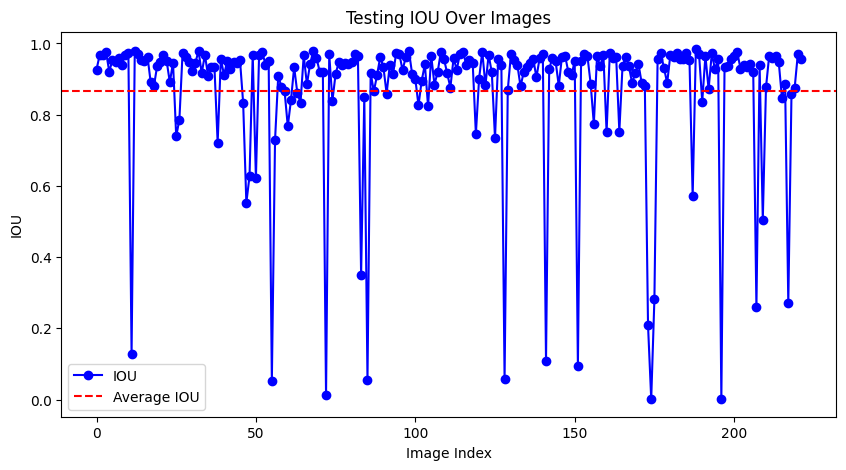

In [11]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the Excel file
excel_file_path = "/content/drive/MyDrive/Colab Notebooks/zrg/test_loss_values_Final.xlsx"
metrics_df = pd.read_excel(excel_file_path)

# Filter out the 'Average' row
filtered_metrics_df = metrics_df[metrics_df['Image File Name'] != 'Average']

# Extract Average IOU from the 'Average' row
average_iou = metrics_df[metrics_df['Image File Name'] == 'Average']['IOU'].values[0]

# Plot IOU scores
plt.figure(figsize=(10, 5))
plt.plot(filtered_metrics_df['IOU'], marker='o', linestyle='-', color='b', label='IOU')
plt.axhline(y=average_iou, color='red', linestyle='--', label='Average IOU')
plt.title('Testing IOU Over Images')
plt.xlabel('Image Index')
plt.ylabel('IOU')
plt.legend()
plt.show()
